<a href="https://colab.research.google.com/github/huixinn/data/blob/main/confusion.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Install Detectron2

In [89]:
# install dependencies: 
!pip install pyyaml==5.1
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

1.8.1+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [90]:
# install detectron2: (Colab has CUDA 10.1 + torch 1.8)
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
import torch
assert torch.__version__.startswith("1.8")   # need to manually install torch 1.8 if Colab changes its default version
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.8/index.html
# exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.8/index.html


In [1]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# Download Dataset

In [2]:
!wget https://github.com/huixinn/data/raw/main/data.zip
!unzip data.zip > /dev/null

--2021-05-10 11:43:34--  https://github.com/huixinn/data/raw/main/data.zip
Resolving github.com (github.com)... 140.82.113.4
Connecting to github.com (github.com)|140.82.113.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/huixinn/data/main/data.zip [following]
--2021-05-10 11:43:34--  https://raw.githubusercontent.com/huixinn/data/main/data.zip
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 21139683 (20M) [application/zip]
Saving to: ‘data.zip’

data.zip            100%[===================>]  20.16M  --.-KB/s    in 0.09s   

2021-05-10 11:43:34 (218 MB/s) - ‘data.zip’ saved [21139683/21139683]



In [3]:
!ls data

labelme2coco.py  test  test.json  train  train.json


# Prepare Dataset

In [54]:
from detectron2.data.datasets import register_coco_instances

for d in ["train", "test"]:
  register_coco_instances(f"data_{d}", {}, f"data/{d}.json", f"data/{d}")

AssertionError: ignored

visualize 20 random images from training set

WARNING [05/10 11:43:45 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/10 11:43:45 d2.data.datasets.coco]: Loaded 171 images in COCO format from data/train.json


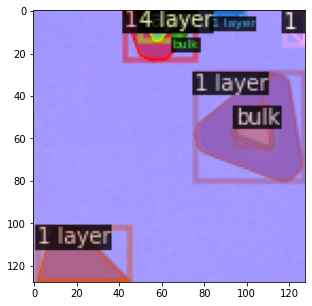

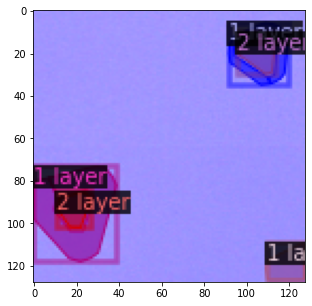

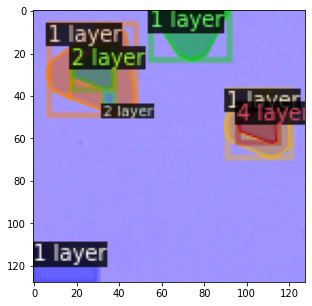

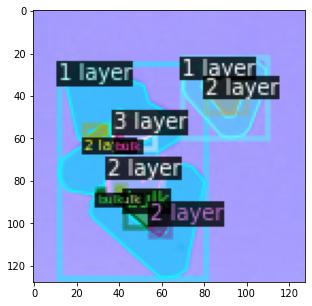

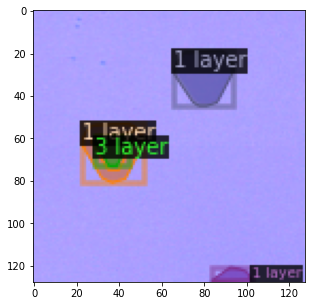

...

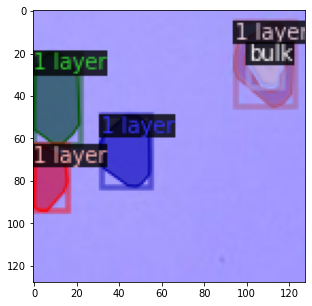

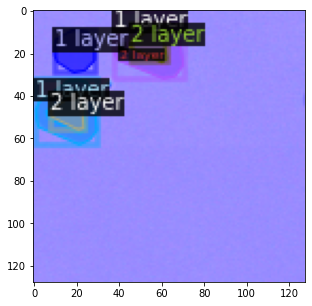

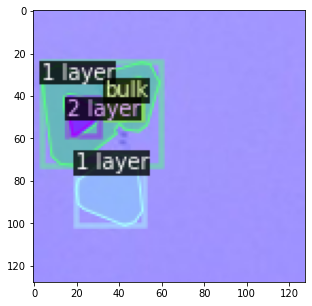

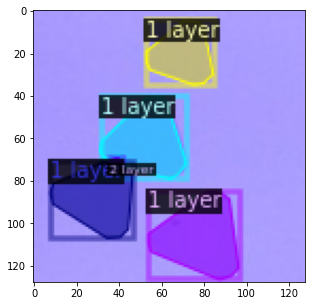

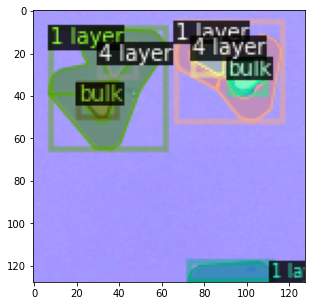

In [5]:
import random
from detectron2.data import DatasetCatalog, MetadataCatalog

dataset_dicts = DatasetCatalog.get("data_train")
data_metadata = MetadataCatalog.get("data_train")

for d in random.sample(dataset_dicts, 20):
    img = cv2.imread(d["file_name"])
    vis = Visualizer(img[:, :, ::-1], metadata=data_metadata, scale=0.5)
    vis = vis.draw_dataset_dict(d)

    plt.figure(figsize = (5, 5))
    plt.imshow(cv2.cvtColor(vis.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    plt.show()

# Train

In [6]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("data_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2  #batch size
cfg.SOLVER.BASE_LR = 0.00025  # learning rate
cfg.SOLVER.MAX_ITER = 2000    # 2000 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 5  #5 classes

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[05/10 11:44:04 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:10, 17.2MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (6, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (6,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (20, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (20,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to

[05/10 11:44:16 d2.engine.train_loop]: Starting training from iteration 0
[05/10 11:44:26 d2.utils.events]:  eta: 0:15:09  iter: 19  total_loss: 3.464  loss_cls: 1.729  loss_box_reg: 0.6282  loss_mask: 0.6924  loss_rpn_cls: 0.3241  loss_rpn_loc: 0.03294  time: 0.4579  data_time: 0.0141  lr: 4.9953e-06  max_mem: 2500M
[05/10 11:44:35 d2.utils.events]:  eta: 0:14:58  iter: 39  total_loss: 3.186  loss_cls: 1.538  loss_box_reg: 0.6926  loss_mask: 0.6881  loss_rpn_cls: 0.3371  loss_rpn_loc: 0.03596  time: 0.4567  data_time: 0.0077  lr: 9.9902e-06  max_mem: 2533M
[05/10 11:44:44 d2.utils.events]:  eta: 0:14:54  iter: 59  total_loss: 2.807  loss_cls: 1.191  loss_box_reg: 0.7222  loss_mask: 0.6784  loss_rpn_cls: 0.1437  loss_rpn_loc: 0.03212  time: 0.4593  data_time: 0.0054  lr: 1.4985e-05  max_mem: 2533M
[05/10 11:44:54 d2.utils.events]:  eta: 0:15:06  iter: 79  total_loss: 2.623  loss_cls: 0.9579  loss_box_reg: 0.8368  loss_mask: 0.6672  loss_rpn_cls: 0.1951  loss_rpn_loc: 0.04542  time: 0.4

In [7]:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

# Inference and Evaluation

create predictor

In [8]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = ("data_test", )
predictor = DefaultPredictor(cfg)

visualize 40 annotated images

In [98]:
from detectron2.data import detection_utils as utils
import detectron2.data.transforms as T
import copy

def custom_mapper(dataset_dict):
    dataset_dict = copy.deepcopy(dataset_dict)  # it will be modified by code below
    image = utils.read_image(dataset_dict["file_name"], format="BGR")
    transform_list = [
        T.Resize((256,256))
    ]
    image, transforms = T.apply_transform_gens(transform_list, image)
    dataset_dict["image"] = torch.as_tensor(image.transpose(2, 0, 1).astype("float32"))

    annos = [
        utils.transform_instance_annotations(obj, transforms, image.shape[:2])
        for obj in dataset_dict.pop("annotations")
        if obj.get("iscrowd", 0) == 0
    ]
    instances = utils.annotations_to_instances(annos, image.shape[:2])
    dataset_dict["instances"] = utils.filter_empty_instances(instances)
    return dataset_dict

WARNING [05/10 15:07:15 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/10 15:07:15 d2.data.datasets.coco]: Loaded 40 images in COCO format from data/test.json


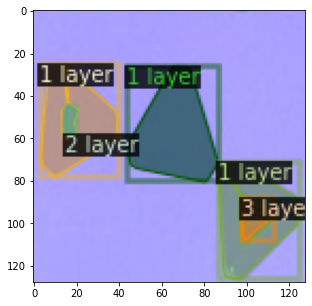

['1 layer', '2 layer', '1 layer', '1 layer', '3 layer']


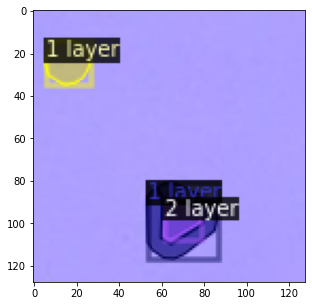

['1 layer', '1 layer', '2 layer']


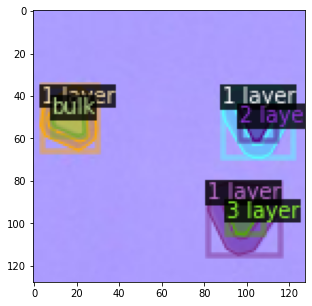

['1 layer', 'bulk', '1 layer', '2 layer', '1 layer', '3 layer']


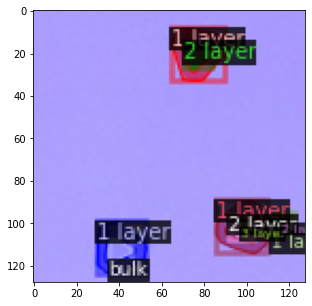

['1 layer', '2 layer', '1 layer', '2 layer', '3 layer', '1 layer', '2 layer', 'bulk', '1 layer']


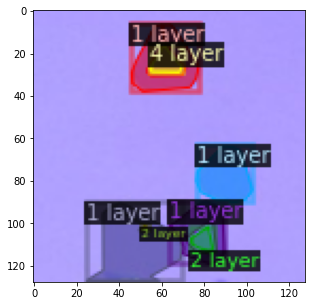

['1 layer', '4 layer', '1 layer', '1 layer', '2 layer', '1 layer', '2 layer']


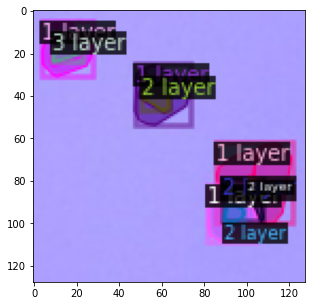

['1 layer', '3 layer', '1 layer', '2 layer', '1 layer', '2 layer', '1 layer', '2 layer', '2 layer']


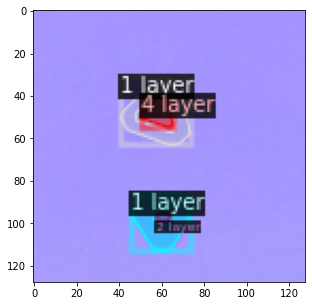

['1 layer', '4 layer', '1 layer', '2 layer']


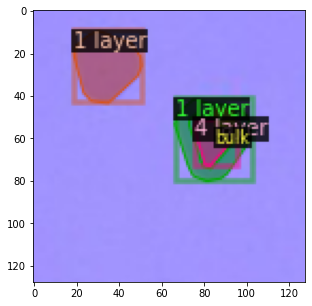

['1 layer', '1 layer', '4 layer', 'bulk']


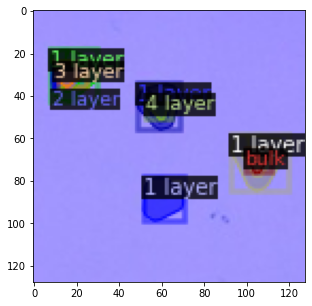

['1 layer', '4 layer', '1 layer', 'bulk', '1 layer', '1 layer', '2 layer', '3 layer']


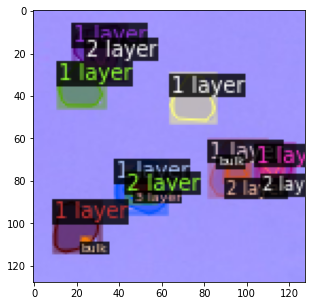

['1 layer', '3 layer', '1 layer', '2 layer', '1 layer', '1 layer', '1 layer', '2 layer', '2 layer', '2 layer', '1 layer', '1 layer', 'bulk', 'bulk']


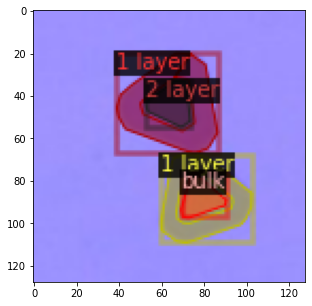

['1 layer', '2 layer', '1 layer', 'bulk']


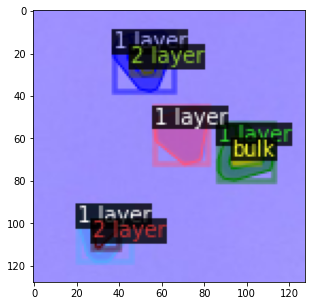

['1 layer', '2 layer', '1 layer', '1 layer', 'bulk', '1 layer', '2 layer']


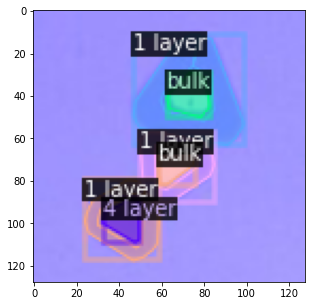

['1 layer', 'bulk', '1 layer', 'bulk', '1 layer', '4 layer']


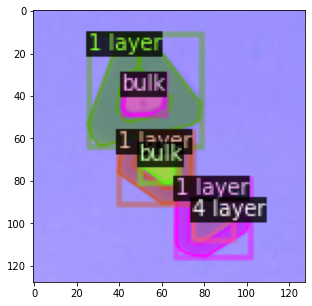

['1 layer', '1 layer', 'bulk', '1 layer', '4 layer', 'bulk']


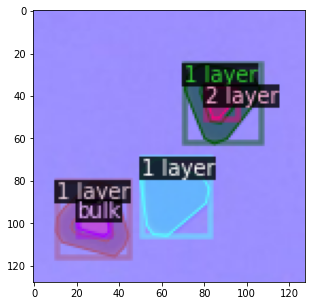

['1 layer', 'bulk', '1 layer', '1 layer', '2 layer']


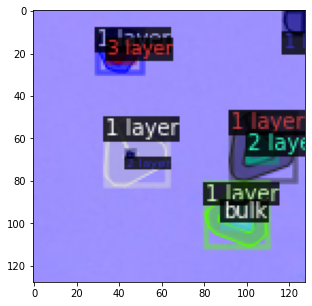

['1 layer', '3 layer', '1 layer', '2 layer', '1 layer', '1 layer', '2 layer', '1 layer', 'bulk']


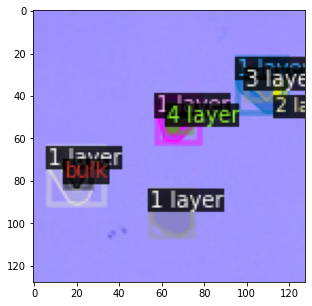

['3 layer', '2 layer', '1 layer', '1 layer', '4 layer', '1 layer', 'bulk', '1 layer']


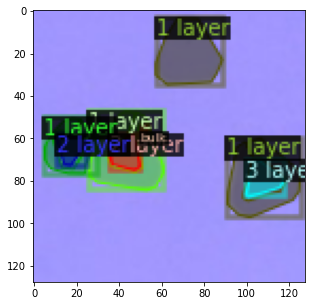

['1 layer', '2 layer', '1 layer', '2 layer', '1 layer', 'bulk', '1 layer', '3 layer']


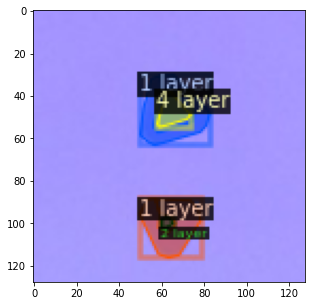

['1 layer', '4 layer', '1 layer', '2 layer']


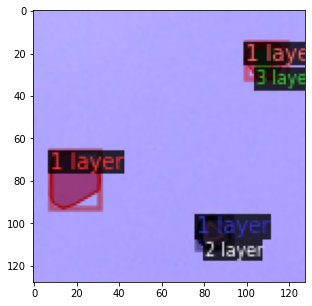

['1 layer', '1 layer', '3 layer', '1 layer', '2 layer']


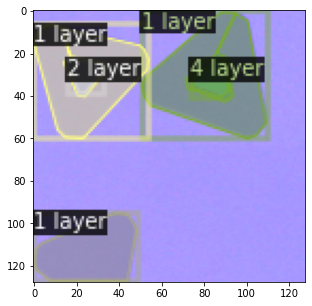

['1 layer', '4 layer', '1 layer', '2 layer', '1 layer']


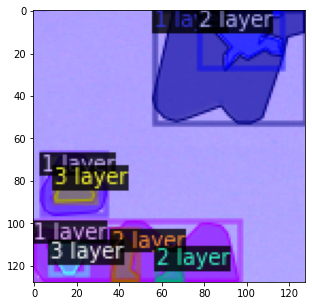

['2 layer', '2 layer', '2 layer', '1 layer', '1 layer', '3 layer', '1 layer', '3 layer']


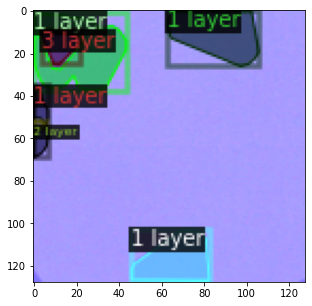

['1 layer', '2 layer', '1 layer', '1 layer', '1 layer', '3 layer']


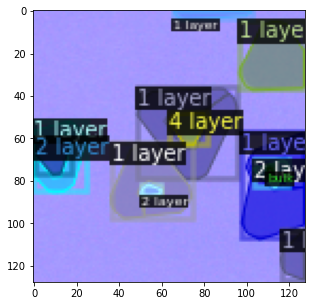

['1 layer', '1 layer', '1 layer', '2 layer', '1 layer', '2 layer', '1 layer', '4 layer', '1 layer', '2 layer', 'bulk', '1 layer']


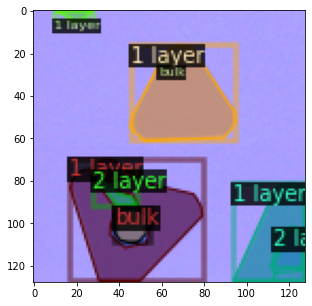

['1 layer', '1 layer', '2 layer', 'bulk', 'bulk', '1 layer', '1 layer', '2 layer']


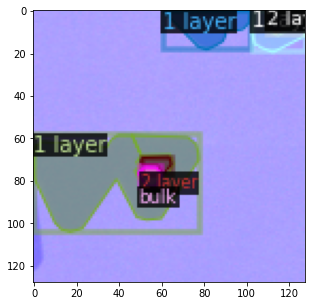

['2 layer', '1 layer', '1 layer', '1 layer', 'bulk', '2 layer']


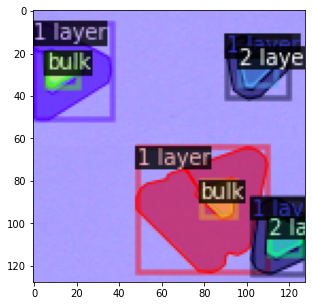

['1 layer', 'bulk', '1 layer', '2 layer', '1 layer', 'bulk', '1 layer', '2 layer']


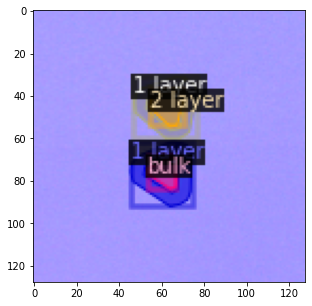

['1 layer', '2 layer', '1 layer', 'bulk']


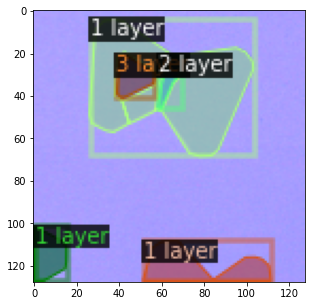

['2 layer', '3 layer', '1 layer', '1 layer', '1 layer']


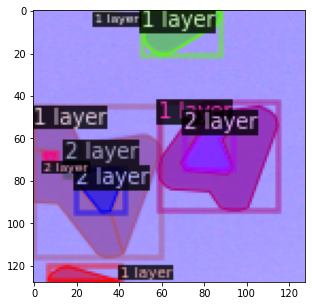

['2 layer', '2 layer', '2 layer', '2 layer', '1 layer', '1 layer', '1 layer', '1 layer', '1 layer']


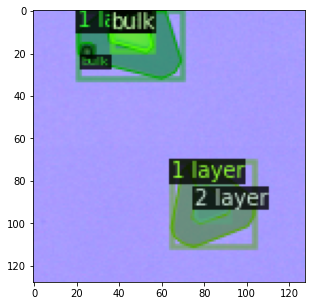

['bulk', 'bulk', '1 layer', '1 layer', '2 layer']


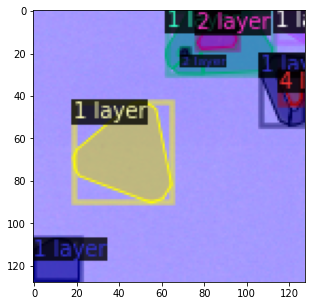

['1 layer', '2 layer', '2 layer', '1 layer', '1 layer', '4 layer', '1 layer', '1 layer']


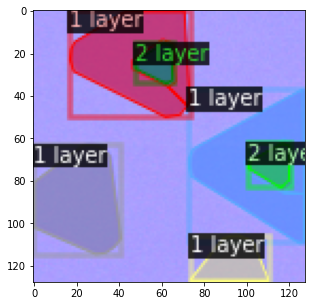

['1 layer', '2 layer', '1 layer', '2 layer', '1 layer', '1 layer']


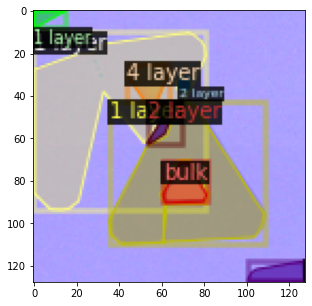

['4 layer', 'bulk', '2 layer', '2 layer', '1 layer', '1 layer', '1 layer', '1 layer']


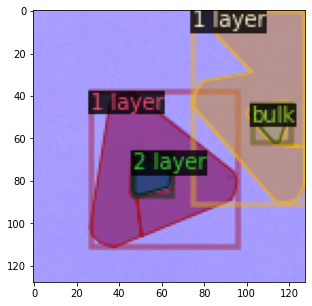

['1 layer', 'bulk', '1 layer', '2 layer']


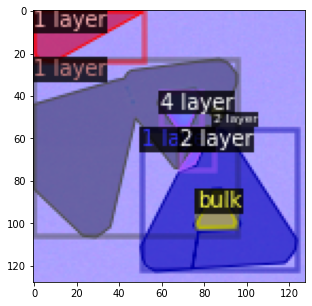

['2 layer', '1 layer', '1 layer', '2 layer', '4 layer', '1 layer', 'bulk']


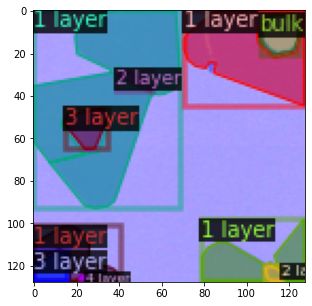

['2 layer', 'bulk', '1 layer', '1 layer', '3 layer', '3 layer', '1 layer', '4 layer', '2 layer', '1 layer']


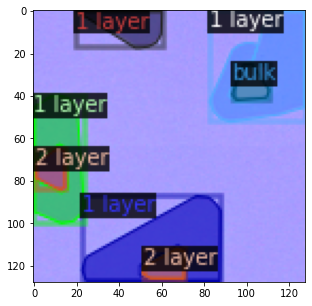

['bulk', '1 layer', '1 layer', '1 layer', '2 layer', '1 layer', '2 layer']


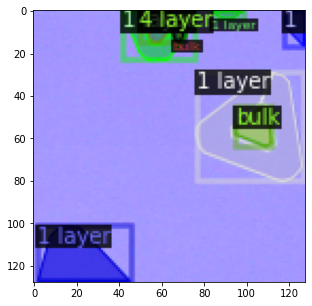

['bulk', '4 layer', '1 layer', '1 layer', '1 layer', '1 layer', 'bulk', '1 layer']


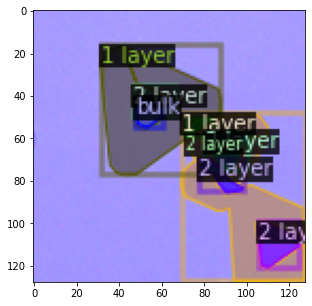

['bulk', '2 layer', '2 layer', '2 layer', '2 layer', '2 layer', '1 layer', '1 layer']


In [122]:
dataset_dicts = DatasetCatalog.get("data_test")
data_metadata = MetadataCatalog.get("data_test")

for d in dataset_dicts:
    img = cv2.imread(d["file_name"])
    vis = Visualizer(img[:, :, ::-1], metadata=data_metadata, scale=0.5)
    vis = vis.draw_dataset_dict(d)

    plt.figure(figsize = (5, 5))
    plt.imshow(cv2.cvtColor(vis.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    plt.show()

    res = custom_mapper(d)
    gt_classes = res['instances'].gt_classes.cpu().tolist()
    class_names = MetadataCatalog.get("data_test").thing_classes
    gt_class_names = list(map(lambda x: class_names[x], gt_classes))
    print(gt_class_names)


visualize 40 predicted result from test set

WARNING [05/10 15:31:20 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/10 15:31:20 d2.data.datasets.coco]: Loaded 40 images in COCO format from data/test.json
['1 layer', '1 layer', '1 layer', '2 layer', '2 layer', 'bulk']


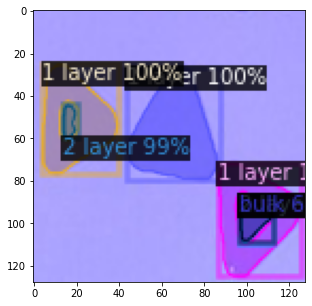

['1 layer', '1 layer', '2 layer']


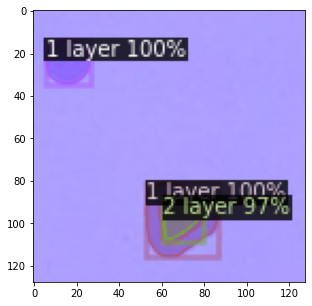

['1 layer', '1 layer', '1 layer', 'bulk', '2 layer', '3 layer', '2 layer']


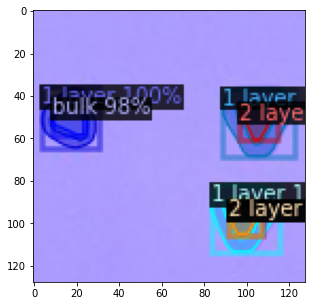

['1 layer', '1 layer', '1 layer', 'bulk', '1 layer', '2 layer', '2 layer']


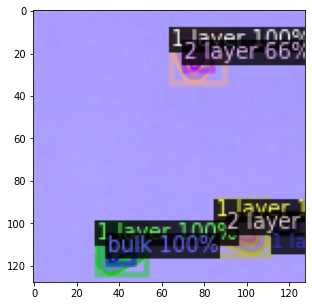

['1 layer', '1 layer', '1 layer', '2 layer', '1 layer', '4 layer', '1 layer', '2 layer', '2 layer']


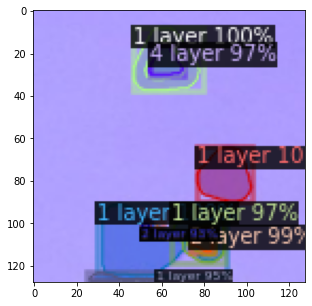

['1 layer', '1 layer', '1 layer', '2 layer', '2 layer', '2 layer', '1 layer', '3 layer']


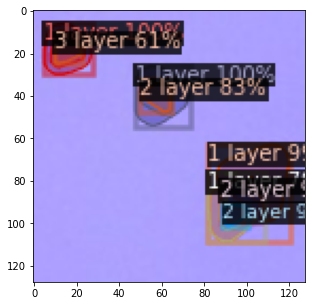

['1 layer', '1 layer', '4 layer', '2 layer']


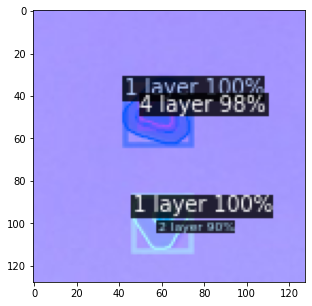

['1 layer', '1 layer', 'bulk', '2 layer']


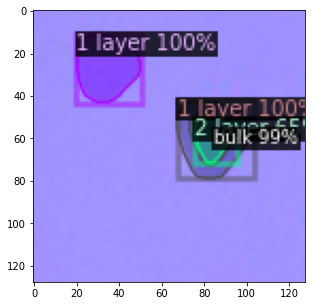

['1 layer', '1 layer', '1 layer', '1 layer', 'bulk', '3 layer', '3 layer', '4 layer']


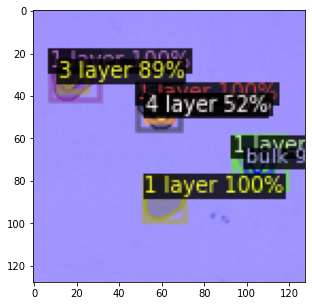

['1 layer', '1 layer', '1 layer', '1 layer', '1 layer', '1 layer', '2 layer', '1 layer', 'bulk', '2 layer', '2 layer', '2 layer', '2 layer', '1 layer', 'bulk']


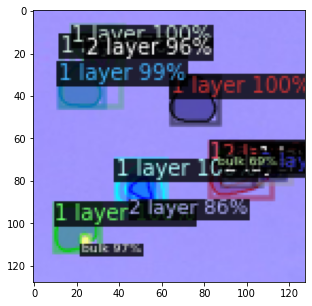

['1 layer', '1 layer', '2 layer', 'bulk']


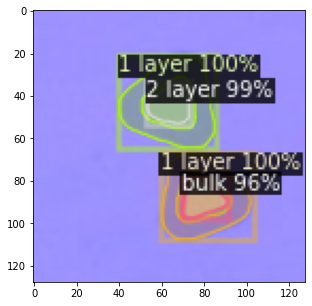

['1 layer', '1 layer', '1 layer', '1 layer', 'bulk', '2 layer', '2 layer']


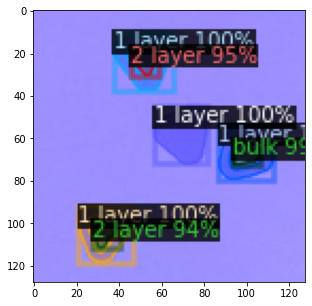

['1 layer', 'bulk', 'bulk', '1 layer', '2 layer', '1 layer', '1 layer', 'bulk', '2 layer', '1 layer']


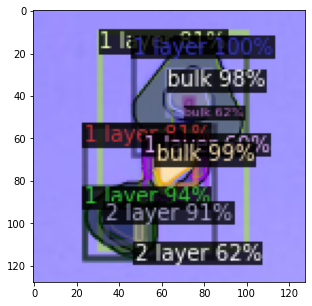

['1 layer', 'bulk', '1 layer', 'bulk', '2 layer', '1 layer', '1 layer']


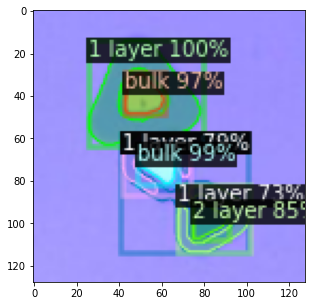

['1 layer', '1 layer', '1 layer', 'bulk', '2 layer']


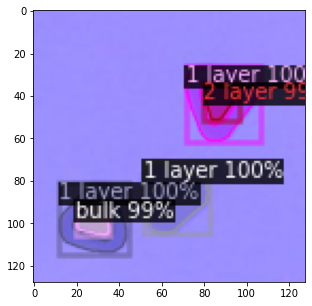

['1 layer', '1 layer', '1 layer', '1 layer', '1 layer', '2 layer', 'bulk', '2 layer']


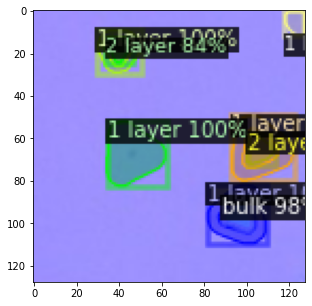

['1 layer', '1 layer', '1 layer', '1 layer', 'bulk', '3 layer', '3 layer', '4 layer']


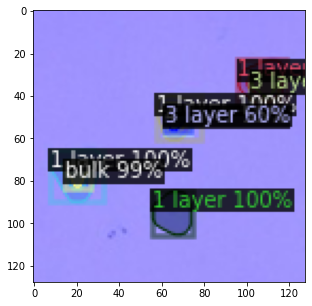

['1 layer', '1 layer', '1 layer', '2 layer', '2 layer', '2 layer', '1 layer', 'bulk']


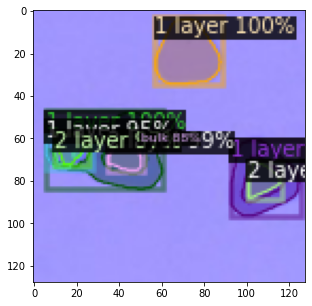

['1 layer', '1 layer', '4 layer', '2 layer']


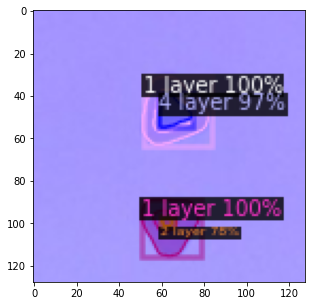

['1 layer', '1 layer', '1 layer', '2 layer', '3 layer']


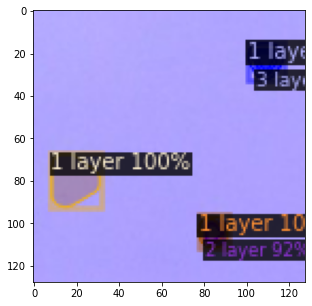

['1 layer', '1 layer', '1 layer', '2 layer', '4 layer']


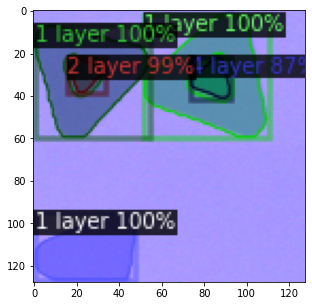

['1 layer', '1 layer', '1 layer', '2 layer', '1 layer', '1 layer', '2 layer', '2 layer', '2 layer', '2 layer', '1 layer', '2 layer', '2 layer', '3 layer']


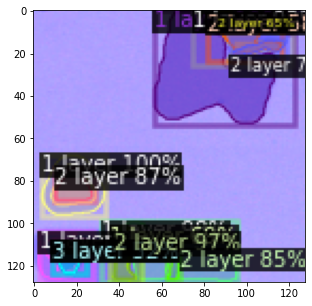

['1 layer', '1 layer', '1 layer', '1 layer', '2 layer', '3 layer']


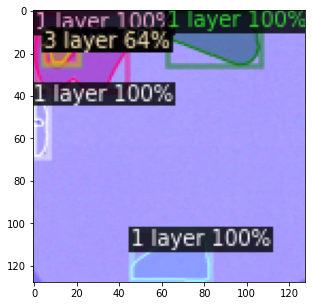

['1 layer', '1 layer', '1 layer', '1 layer', '1 layer', '1 layer', '1 layer', 'bulk', '2 layer', '2 layer', '4 layer', '2 layer']


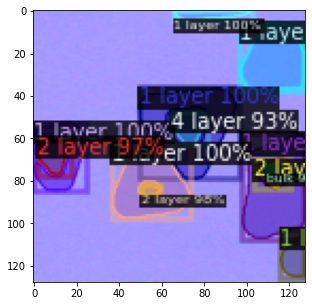

['1 layer', '1 layer', '1 layer', '1 layer', '2 layer', '2 layer', 'bulk', 'bulk', '2 layer']


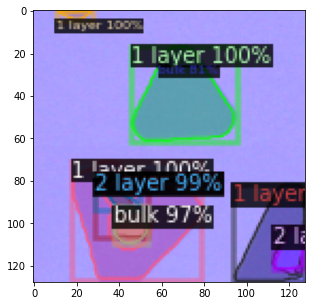

['1 layer', '1 layer', '1 layer', 'bulk', '2 layer', '1 layer', 'bulk']


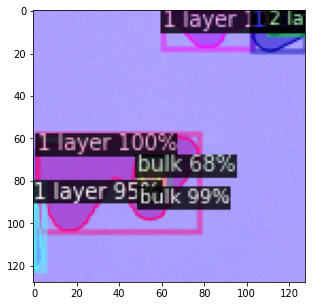

['1 layer', '1 layer', '1 layer', '1 layer', 'bulk', 'bulk', '2 layer', '2 layer']


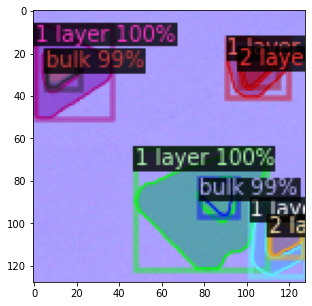

['1 layer', '1 layer', 'bulk', '2 layer']


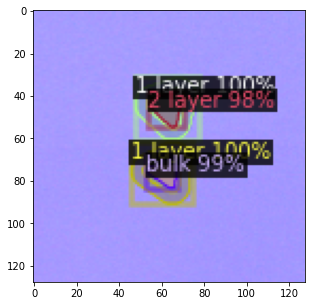

['1 layer', '1 layer', '1 layer', '2 layer', '3 layer']


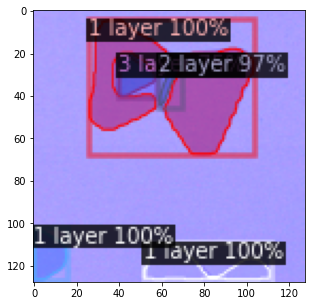

['1 layer', '1 layer', '1 layer', '1 layer', '2 layer', '2 layer', '2 layer', '2 layer']


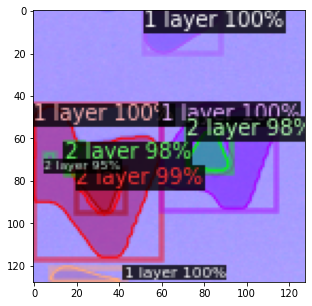

['1 layer', '1 layer', 'bulk', 'bulk', '2 layer']


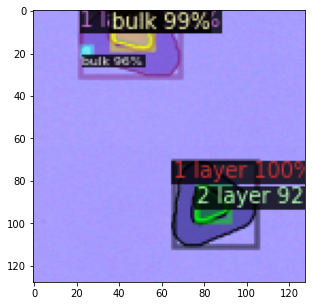

['1 layer', '1 layer', '1 layer', '1 layer', '1 layer', '2 layer', '4 layer', '1 layer', '2 layer']


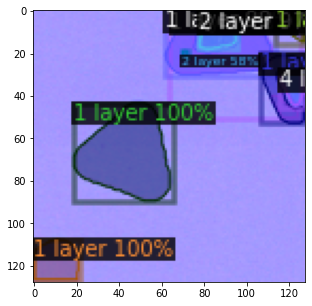

['1 layer', '1 layer', '1 layer', '1 layer', '2 layer', '2 layer']


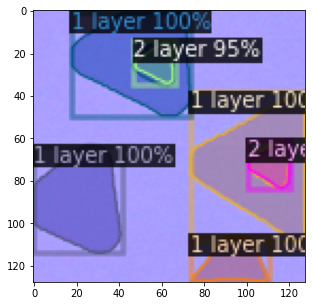

['1 layer', '1 layer', '1 layer', '1 layer', '2 layer', 'bulk', '2 layer', '2 layer', '4 layer', '1 layer']


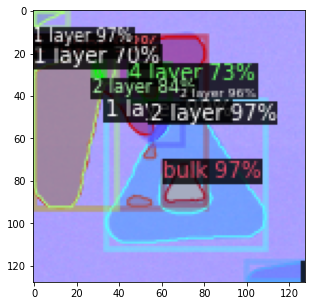

['1 layer', '1 layer', 'bulk', '2 layer']


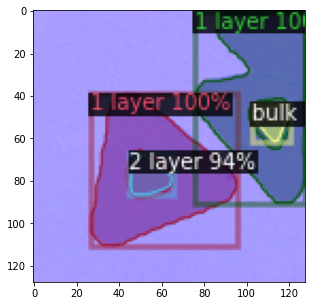

['1 layer', '1 layer', '1 layer', '2 layer', 'bulk', '2 layer', '2 layer', '4 layer', '1 layer']


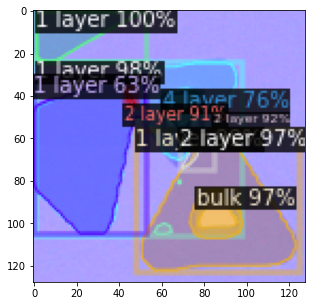

['1 layer', '1 layer', '1 layer', '1 layer', '1 layer', '2 layer', '2 layer', 'bulk', '1 layer', '1 layer', '1 layer', '2 layer', '2 layer', '1 layer', '3 layer']


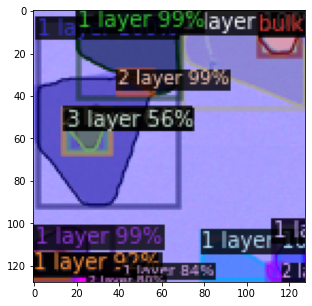

['1 layer', '1 layer', '1 layer', '1 layer', 'bulk', '2 layer', '1 layer', '2 layer']


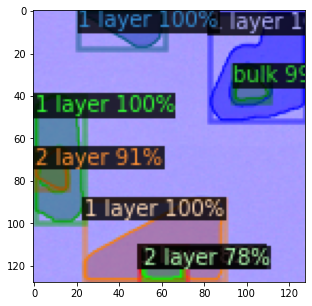

['1 layer', '1 layer', '1 layer', '1 layer', 'bulk', '1 layer', 'bulk', '4 layer']


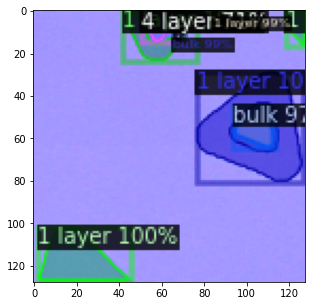

['1 layer', 'bulk', '2 layer', '1 layer', '2 layer', '2 layer', '1 layer', '2 layer', '1 layer']


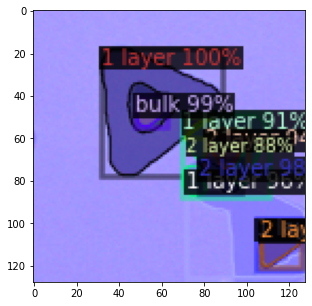

In [137]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = DatasetCatalog.get("data_test")
for d in dataset_dicts: 
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)   
    vis = Visualizer(im[:, :, ::-1],
                   metadata=data_metadata, 
                   scale=0.5, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    pred_classes = outputs['instances'].pred_classes.cpu().tolist()
    class_names = MetadataCatalog.get("data_test").thing_classes
    pred_class_names = list(map(lambda x: class_names[x], pred_classes))
    print(pred_class_names)

    vis = vis.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.figure(figsize = (5, 5))
    plt.imshow(cv2.cvtColor(vis.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    plt.show()


# AP metric

In [105]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("data_test", ("bbox", "segm"), False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "data_test")
print(inference_on_dataset(trainer.model, val_loader, evaluator))

WARNING [05/10 14:45:41 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/10 14:45:41 d2.data.datasets.coco]: Loaded 40 images in COCO format from data/test.json
[05/10 14:45:41 d2.data.build]: Distribution of instances among all 5 categories:
|  category  | #instances   |  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|:----------:|:-------------|
|  1 layer   | 141          |  2 layer   | 68           |  3 layer   | 16           |
|  4 layer   | 15           |    bulk    | 33           |            |              |
|   total    | 273          |            |              |            |              |
[05/10 14:45:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[05/10 14:45:41 d2.data.common]: Serializing 40 elements to byte tensors and co

# confusion

In [142]:
# confusion matrix in sklearn
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

dataset_dicts = DatasetCatalog.get("data_test")
data_metadata = MetadataCatalog.get("data_test")

for d in dataset_dicts:
    img = cv2.imread(d["file_name"])

    res = custom_mapper(d)
    gt = np.array([]) 
    gt_classes = res['instances'].gt_classes
    print(gt_classes)

    outputs = predictor(img)  
    pred_classes = np.array([]) 
    pred_classes = outputs['instances'].pred_classes    
    print(pred_classes)
    print("\n")


WARNING [05/10 15:45:42 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/10 15:45:42 d2.data.datasets.coco]: Loaded 40 images in COCO format from data/test.json
tensor([0, 1, 0, 0, 2])
tensor([0, 0, 0, 1, 1, 4], device='cuda:0')


tensor([0, 0, 1])
tensor([0, 0, 1], device='cuda:0')


tensor([0, 4, 0, 1, 0, 2])
tensor([0, 0, 0, 4, 1, 2, 1], device='cuda:0')


tensor([0, 1, 0, 1, 2, 0, 1, 4, 0])
tensor([0, 0, 0, 4, 0, 1, 1], device='cuda:0')


tensor([0, 3, 0, 0, 1, 0, 1])
tensor([0, 0, 0, 1, 0, 3, 0, 1, 1], device='cuda:0')


tensor([0, 2, 0, 1, 0, 1, 0, 1, 1])
tensor([0, 0, 0, 1, 1, 1, 0, 2], device='cuda:0')


tensor([0, 3, 0, 1])
tensor([0, 0, 3, 1], device='cuda:0')


tensor([0, 0, 3, 4])
tensor([0, 0, 4, 1], device='cuda:0')


tensor([0, 3, 0, 4, 0, 0, 1, 2])
tensor([0, 0, 0, 0, 4, 2, 2, 3], device='cuda:0')


tensor([0, 2, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 4, 4])
tensor([0, 0, 0, 0, 0, 0, 1, 0, 4, 1, 1, 1, 1, 0, 4],

In [ ]:
    # confusion matrix
    #matrix = confusion_matrix(gt_classes,pred_classes, labels=["1 layer","2 layer","3 layer","4 layer","bulk"])
    #print('Confusion matrix : \n',matrix)

    # outcome values order in sklearn
    tp, fn, fp, tn = confusion_matrix(gt_classes,pred_classes,labels=["1 layer","2 layer","3 layer","4 layer","bulk"]).reshape(-1)
    print('Outcome values : \n', tp, fn, fp, tn)

    # classification report for precision, recall f1-score and accuracy
    matrix = classification_report(gt_classes,pred_classes,labels=["1 layer","2 layer","3 layer","4 layer","bulk"])
    print('Classification report : \n',matrix)
